# Trabajo Práctico Nro 3 - Redes Neuronales


In [2]:
# de python, para especificar rutas de archivos y directorios
import os
from pathlib import Path 

# lib para trabajar con arrays
import numpy as np
import pandas as pd

# lib que usamos para mostrar las imágenes
import matplotlib.pyplot as plt
from PIL import Image
import plotly.express as px

# libs que usamos para construir y entrenar redes neuronales, y que además tiene utilidades para leer sets de 
# imágenes
from keras.preprocessing import image_dataset_from_directory
from keras.models import Sequential
from keras.layers import Dense, Input, Dropout, Convolution2D, MaxPooling2D, Flatten
from keras.layers.experimental.preprocessing import Rescaling
from keras.preprocessing.image import load_img, img_to_array

# libs que usamos para tareas generales de machine learning. En este caso, métricas
from sklearn.metrics import accuracy_score, confusion_matrix

# libs que usamos para tareas generales de machine learning: separar conjuntos de datos, evaluar exactitud, etc
from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix

# configuración para que las imágenes se vean dentro del notebook
%matplotlib inline

In [3]:
# lo vamos a estar usando seguido
ANIMALES = "gato", "perro"
# configurar de acuerdo a dónde bajaron los sets de imágenes
TRAIN_DIR = Path('./imagenes_tp3_cv/training_set')
VALIDATION_DIR = Path('./imagenes_tp3_cv/test_set')

In [ ]:
train = image_dataset_from_directory(
    TRAIN_DIR,
    labels="inferred",  # adivinar los labels en base al nombre del sub directorio ("ariel", etc)
    label_mode="categorical",  # tenemos N labels, queremos tuplas de 0s y 1s indicando cuál de los labels es
    class_names=ANIMALES,  # para usar el mismo orden en todos lados
    color_mode="rgb",  # queremos trabajar con las imágenes a color
    image_size=(64, 64),  # para que corra más rápido, vamos a achicar las imágenes
    shuffle=True,  # que recorra el set de imágenes en orden aleatorio
    seed=42,  # semilla para que la aleatoriedad sea repetible
)

validation = image_dataset_from_directory(
    VALIDATION_DIR,
    labels="inferred",
    label_mode="categorical",
    class_names=ANIMALES,
    color_mode="rgb",
    image_size=(64, 64),
    shuffle=True,
    seed=42,
)

## Volumetría de los datos
Dentro de los datos proporcionados hay dos conjuntos de datos: train y test. Cada uno de ellos cuenta con 4.000 y 1.000 imágenes, respectivamente, de cada tipo. Ejemplo: el conjunto de entrenamiento contiene 4.005 imágenes de perros y 4.000 de gatos.

In [5]:
gatos_train = Path("./imagenes_tp3_cv/training_set/gato/")
perros_train = Path("./imagenes_tp3_cv/training_set/perro/")
gatos_validation = Path("./imagenes_tp3_cv/test_set/gato/")
perros_validation = Path("./imagenes_tp3_cv/test_set/perro/")
print("Train set de gatos: ")
print(len(list(gatos_train.rglob("*.jpg"))))
print("Train set de perros: ")
print(len(list(perros_train.rglob("*.jpg"))))
print("-----------------------------------------")
print("Validation set de gatos: ")
print(len(list(gatos_validation.rglob("*.jpg"))))
print("Validation set de perros: ")
print(len(list(perros_validation.rglob("*.jpg"))))

Train set de gatos: 
4000
Train set de perros: 
4005
-----------------------------------------
Validation set de gatos: 
1011
Validation set de perros: 
1012


## Estructura y Tipo de las imágenes

In [6]:
def getImageDimension(path):
    im = Image.open(path)
    width, height = im.size
    return width, height

In [7]:
# cats
print('Gatos: ')
x = [] # width
y = [] # height
for i in range(1, 4000):
    path = str(Path(gatos_train)) + "\cat." + str(i) + ".jpg"
    width, height = getImageDimension(path)
    x.append(width)
    y.append(height)

fig = px.scatter(x=x, y=y)
fig.show()

Gatos: 


In [8]:
# dogs
print('Perros: ')
x = [] # width
y = [] # height
for i in range(1, 4000):
    path = str(Path(perros_train)) + "\dog." + str(i) + ".jpg"
    width, height = getImageDimension(path)
    x.append(width)
    y.append(height)

fig = px.scatter(x=x, y=y)
fig.show()

Perros: 


In [9]:
def get_size_statistics(DIR):
    heights = []
    widths = []
    for img in os.listdir(DIR): 
        path = os.path.join(DIR, img)
        data = np.array(Image.open(path)) #PIL Image library
        heights.append(data.shape[0])
        widths.append(data.shape[1])
    avg_height = sum(heights) / len(heights)
    avg_width = sum(widths) / len(widths)
    print("Promedio de altura: " + str(avg_height))
    print("Máxima Altura: " + str(max(heights)))
    print("Mínima Altura: " + str(min(heights)))
    print('\n')
    print("Promedio de Ancho: " + str(avg_width))
    print("Máximo Ancho: " + str(max(widths)))
    print("Mínimo Ancho: " + str(min(widths)))

In [10]:
print('Estadísticas de imágenes de perros: ')
get_size_statistics(perros_train)

Estadísticas de imágenes de perros: 
Promedio de altura: 364.88414481897627
Máxima Altura: 702
Mínima Altura: 45


Promedio de Ancho: 397.987265917603
Máximo Ancho: 1050
Mínimo Ancho: 57


In [11]:
print('Estadísticas de imágenes de gatos: ')
get_size_statistics(gatos_train)

Estadísticas de imágenes de gatos: 
Promedio de altura: 356.09925
Máxima Altura: 768
Mínima Altura: 41


Promedio de Ancho: 409.61975
Máximo Ancho: 1023
Mínimo Ancho: 59


Como podemos ver, las imágenes cuentan con un tamaño muy diferente las unas de las otras por lo que decidimos reescalar a 64x64 todas las imágenes para unificar el tamaño de las mismas y facilitar el procesamiento de los modelos.

En cuánto al tipo de las mismas, al tratarse de imágenes, cuentan con tres canales los cuáles representan los tres colores (RGB, Red, Green, Blue). Por lo tanto las imágenes serán escaladas a 64x64x3. 

## Distribución de la variable a predecir

Set de train: 


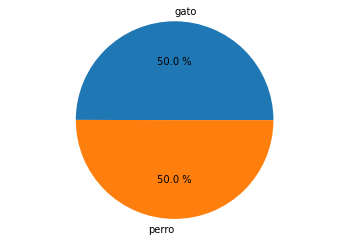

In [12]:
print('Set de train: ')
gatos = 4000
perros = 4005
plt.pie([gatos, perros], labels=ANIMALES, autopct="%0.1f %%")
plt.axis("equal")
plt.show()

Set de validation: 


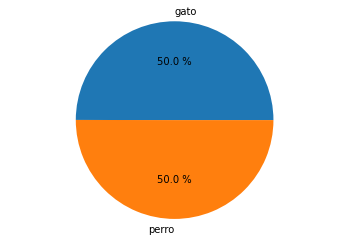

In [13]:
print('Set de validation: ')
gatos = 1011
perros = 1012
plt.pie([gatos, perros], labels=ANIMALES, autopct="%0.1f %%")
plt.axis("equal")
plt.show()

Como podemos apreciar en los dos gráficos, la variable a predecir está completamente balanceada.

In [14]:
def sample_images(dataset):
    plt.figure(figsize=(10, 10))
    for images, labels in dataset.take(1):
        for i in range(9):
            ax = plt.subplot(3, 3, i + 1)
            plt.imshow(images[i].numpy().astype("uint8"))
            plt.title(ANIMALES[np.argmax(labels[i])])
            plt.axis("off")

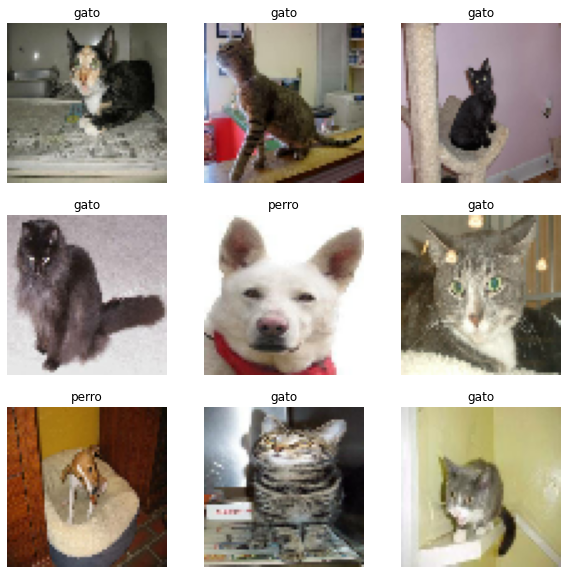

In [15]:
sample_images(train)

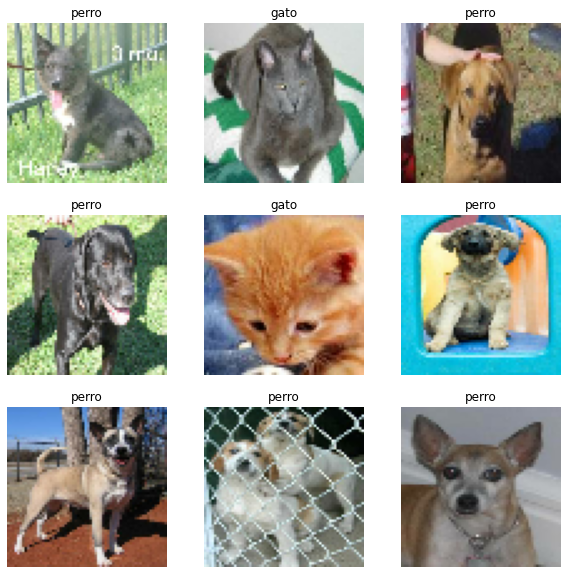

In [16]:
sample_images(validation)

## Red neuronal

### Red MLP

In [18]:
model_mlp_bueno = Sequential([
    # si queremos usar MLP básico:
    Rescaling(1/255, input_shape=(64, 64, 3)),
    Dense(50, activation='relu'),
    Dropout(0.4),
    # /fin MLP básico
    
    Flatten(),
    
    Dense(10, activation='relu'),
    Dense(10, activation='relu'),
    Dropout(0.1),
    Dense(10, activation='relu'),
    Dense(20, activation='relu'),
    Dropout(0.1),
    Dense(20, activation='relu'),
    Dense(10, activation='relu'),
    Dropout(0.1),
    Dense(10, activation='relu'),
    Dense(10, activation='relu'),
    Dropout(0.1),
    Dense(10, activation='relu'),
    Dense(5, activation='relu'),
    Dense(len(ANIMALES), activation='sigmoid'),
])

model_mlp_bueno.compile(
    optimizer='adam',
    loss='binary_crossentropy',
    metrics=['accuracy',],
)

In [19]:
history_mlp = model_mlp_bueno.fit(
    train,
    epochs=10,
    batch_size=128,
    validation_data=validation
)

Epoch 1/10
251/251 [==============================] - 26s 99ms/step - loss: 0.6944 - accuracy: 0.4993 - val_loss: 0.6904 - val_accuracy: 0.5522
Epoch 2/10
251/251 [==============================] - 25s 98ms/step - loss: 0.6863 - accuracy: 0.5525 - val_loss: 0.6542 - val_accuracy: 0.6426
Epoch 3/10
251/251 [==============================] - 25s 98ms/step - loss: 0.6528 - accuracy: 0.6248 - val_loss: 0.6252 - val_accuracy: 0.6624
Epoch 4/10
251/251 [==============================] - 25s 98ms/step - loss: 0.6292 - accuracy: 0.6541 - val_loss: 0.6169 - val_accuracy: 0.6673
Epoch 5/10
251/251 [==============================] - 25s 99ms/step - loss: 0.6056 - accuracy: 0.6813 - val_loss: 0.6206 - val_accuracy: 0.6767
Epoch 6/10
251/251 [==============================] - 25s 97ms/step - loss: 0.5935 - accuracy: 0.6846 - val_loss: 0.6009 - val_accuracy: 0.6985
Epoch 7/10
251/251 [==============================] - 25s 97ms/step - loss: 0.5841 - accuracy: 0.6924 - val_loss: 0.6064 - val_accuracy:

######################### train #########################
accuracy 0.7502810743285446


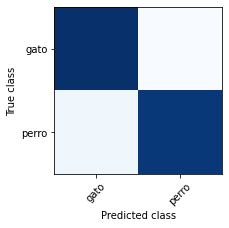

######################### validation #########################
accuracy 0.6870983687592684


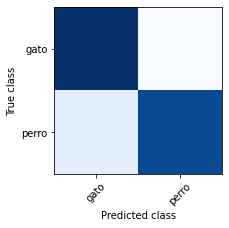

In [20]:
datasets = (
    ("train", train),
    ("validation", validation),   
)

for dataset_name, dataset in datasets:
    print('#' * 25, dataset_name, '#' * 25)

    # el dataset se itera en batches, así que calculams predicciones y labels por cada batch, y luego 
    # concatenamos todo
    batches_predictions = []
    batches_labels =  []
    
    for batch_images, batch_labels in dataset:
        # super importante: usamos argmax para convertir cosas de este formato:
        # [(0, 1, 0), (1, 0, 0), (1, 0, 0), (0, 0, 1)]
        # a este formato (donde tenemos el índice de la clase que tiene número más alto):
        # [1, 0, 0, 2]
        batches_predictions.append(np.argmax(model_mlp_bueno.predict(batch_images), axis=-1))
        batches_labels.append(np.argmax(batch_labels, axis=-1))

    predictions = np.concatenate(batches_predictions)
    labels = np.concatenate(batches_labels)
    
    print('accuracy', accuracy_score(labels, predictions))

    # graficamos la confussion matrix
    plt.figure(figsize=(3, 4))
        
    plt.xticks([0, 1], ANIMALES, rotation=45)
    plt.yticks([0, 1], ANIMALES)
    plt.xlabel('Predicted class')
    plt.ylabel('True class')

    plt.imshow(
        confusion_matrix(labels, predictions), 
        cmap=plt.cm.Blues,
        interpolation='nearest',
    )

    plt.show()

In [103]:
from IPython.display import Image, display


def show_and_predict_mlp(image_path):
    image_array = img_to_array(load_img(image_path, target_size=(64, 64)))
    inputs = np.array([image_array])  # armamos un "dataset" con solo esa imagen
    predictions = model_cnn_3.predict(inputs)
    display(Image(image_path, width=500))
    print("Prediction:", ANIMALES[np.argmax(predictions)])
    print("Prediction detail:", predictions)

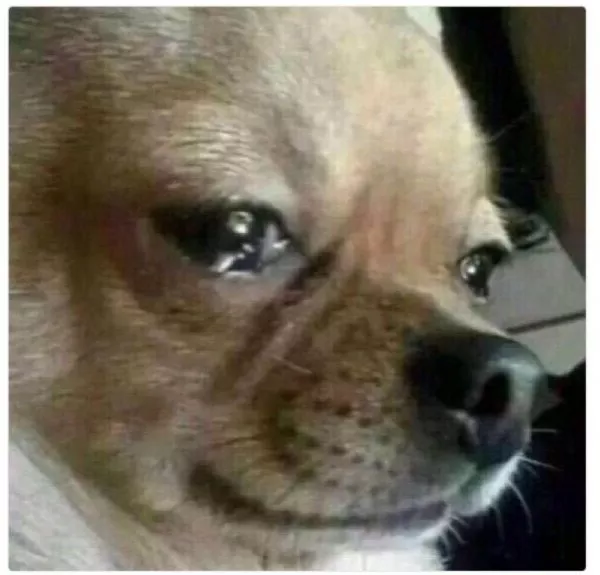

Prediction: perro
Prediction detail: [[0.30010363 0.7033874 ]]


In [105]:
show_and_predict_mlp("./prueba/perrito_llorando.png")

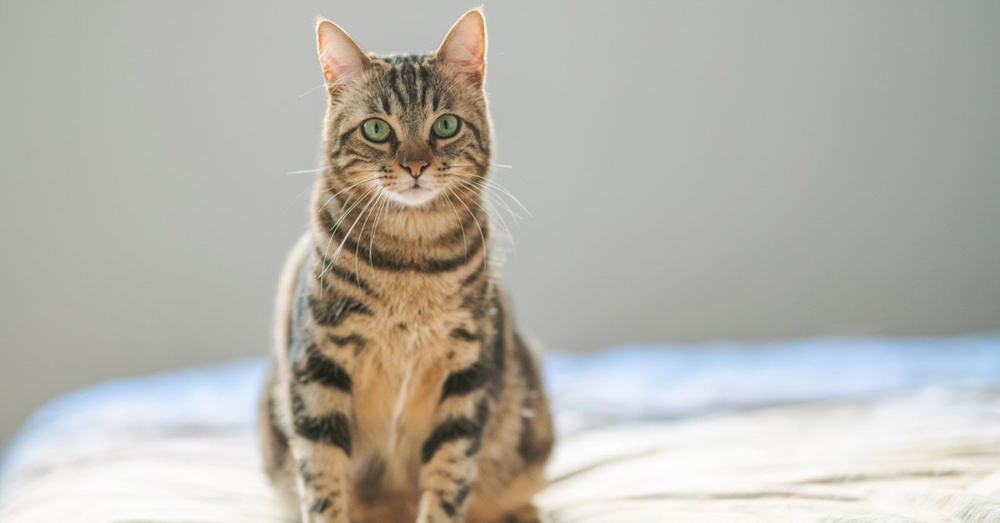

Prediction: gato
Prediction detail: [[0.7701696  0.22321072]]


In [106]:
show_and_predict_mlp("./prueba/gato2.png")

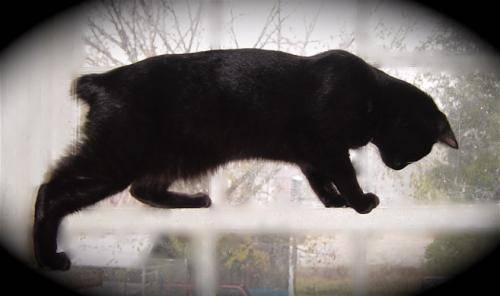

Prediction: perro
Prediction detail: [[0.31374243 0.68554044]]


In [113]:
show_and_predict_mlp("./test_set/gato/cat.4554.jpg")

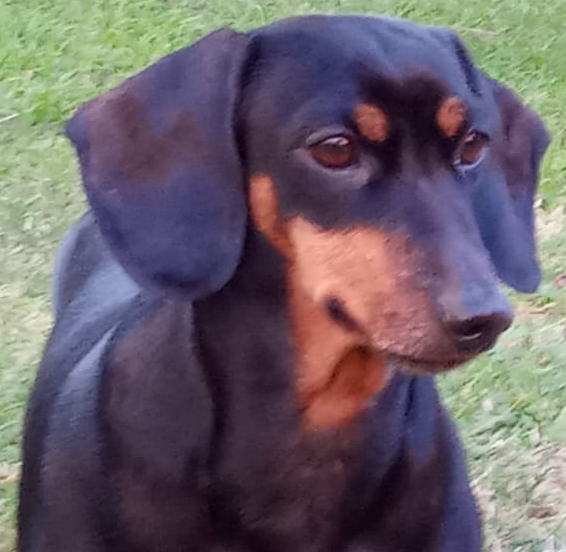

Prediction: perro
Prediction detail: [[0.07521677 0.92758393]]


In [108]:
show_and_predict_mlp("./prueba/cucurucho.png")

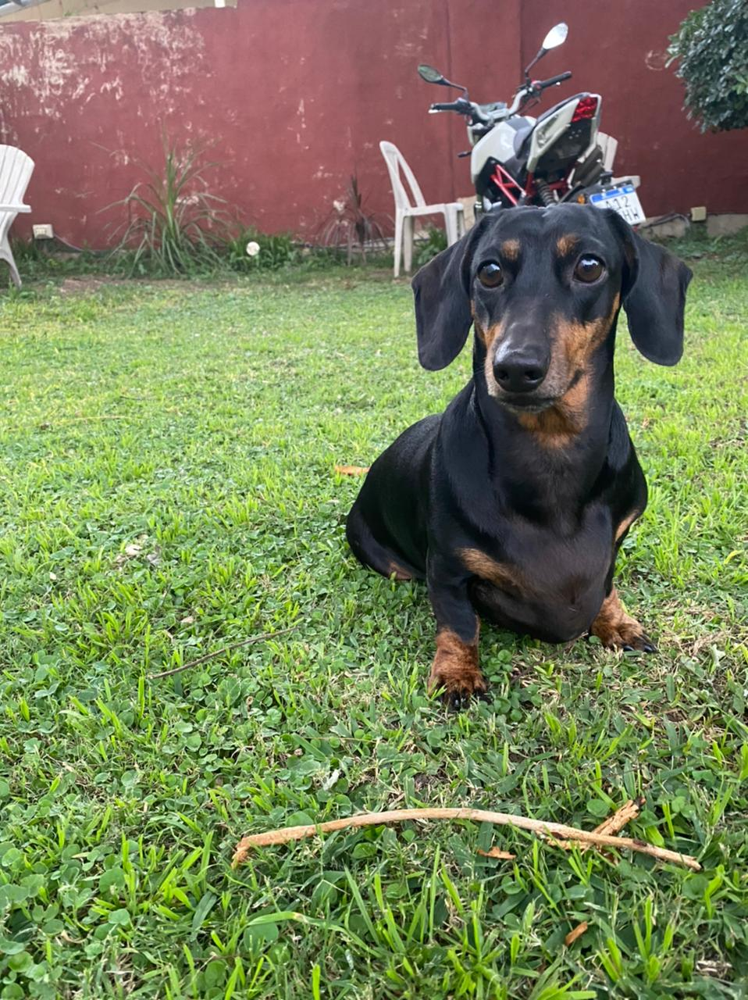

Prediction: perro
Prediction detail: [[7.2264671e-04 9.9920964e-01]]


In [109]:
show_and_predict_mlp("./prueba/cucurucho2.png")

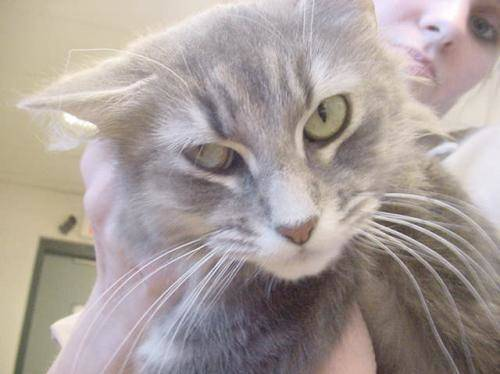

Prediction: perro
Prediction detail: [[0.42159542 0.551137  ]]


In [112]:
show_and_predict_mlp("./test_set/gato/cat.4372.jpg")

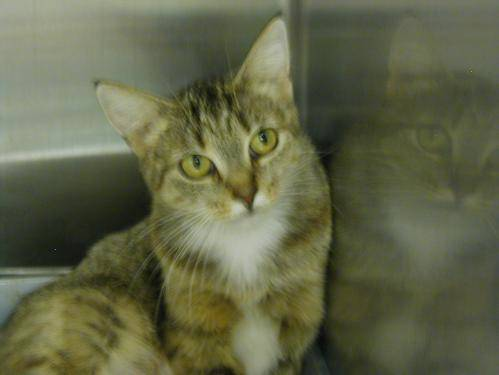

Prediction: gato
Prediction detail: [[0.98198605 0.01809612]]


In [114]:
show_and_predict_mlp("./test_set/gato/cat.4618.jpg")

### Conclusión

Como podemos ver en los resultados, este modelo llega al 75% de accuracy en el training set, y 68% en testing.
A simple vista no consideramos que haya problemas de overfiteo, aunque es algo a tener en cuenta la diferencia de accuracy entre los sets de train y validation. Esto podría darnos un indicio de que, si agregamos más épocas, podría overfitear el modelo.

Realizamos distintos experimentos, y concluimos que el añadir más capas con pocas neuronas ayuda o facilita el aprendizaje del modelo.

Podemos apreciar en la matriz de confusión que el modelo predice con poco error cuando se trata de la imagen de un gato pero, por el contrario, se equivoca más cuando se trata de imágenes de perros.

## Redes Convolucionales

In [55]:
model_cnn_2 = Sequential([
    # el shape de los inputs es alto_imagen * ancho_imagen * cantidad_colores
    # usamos una capa de Rescaling para normalizar las entradas de los datasets
    Rescaling(1/255, input_shape=(64, 64, 3)),

    Convolution2D(filters=8, kernel_size=(4, 4), strides=1, activation='relu', padding='same'),
    Dropout(0.2),
    
    Convolution2D(filters=16, kernel_size=(4, 4), strides=1, activation='relu', padding='same'),
    Dropout(0.2),
    
    Convolution2D(filters=32, kernel_size=(4, 4), strides=1, activation='relu', padding='same'),
    Dropout(0.2),
    
    MaxPooling2D(pool_size=(4, 4)),
    
    Flatten(),
    
    Dense(10, activation='tanh'),
    Dropout(0.2),
    
    Dense(10, activation='tanh'),
    Dropout(0.2),

    Dense(len(ANIMALES), activation='softmax'),
])

model_cnn_2.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy',],
)

In [118]:
model_cnn = Sequential([
    # el shape de los inputs es alto_imagen * ancho_imagen * cantidad_colores
    # usamos una capa de Rescaling para normalizar las entradas de los datasets
    Rescaling(1/255, input_shape=(64, 64, 3)),
    
    Convolution2D(filters=64, kernel_size=(2, 2), strides=1, activation='relu'),
    Dropout(0.2),
    MaxPooling2D(pool_size=(2, 2)), 
    
    Convolution2D(filters=64, kernel_size=(2, 2), strides=1, activation='relu'),
    Dropout(0.2),
    MaxPooling2D(pool_size=(2, 2)),
    
    Convolution2D(filters=128, kernel_size=(2, 2), strides=1, activation='relu'),
    Dropout(0.2),
    MaxPooling2D(pool_size=(2, 2)),
    
    Flatten(),
    
    Dense(128, activation='relu'),
    Dropout(0.2),
    
        
    Dense(1, activation='sigmoid'),
])

model_cnn.compile(
    optimizer='adam',
    loss='categorical_crossentropy',
    metrics=['accuracy',],
)

In [123]:
history_conv = model_cnn.fit(
    train,
    epochs=7,
    batch_size=256,
    validation_data=validation,
)

Epoch 1/7
251/251 [==============================] - 71s 282ms/step - loss: 0.2040 - accuracy: 0.9193 - val_loss: 0.5062 - val_accuracy: 0.7919
Epoch 2/7
251/251 [==============================] - 71s 284ms/step - loss: 0.1795 - accuracy: 0.9272 - val_loss: 0.4896 - val_accuracy: 0.7944
Epoch 3/7
251/251 [==============================] - 71s 281ms/step - loss: 0.1449 - accuracy: 0.9459 - val_loss: 0.5097 - val_accuracy: 0.7978
Epoch 4/7
251/251 [==============================] - 72s 287ms/step - loss: 0.1284 - accuracy: 0.9520 - val_loss: 0.6165 - val_accuracy: 0.7860
Epoch 5/7
251/251 [==============================] - 72s 284ms/step - loss: 0.1094 - accuracy: 0.9580 - val_loss: 0.5671 - val_accuracy: 0.7904
Epoch 6/7
251/251 [==============================] - 74s 292ms/step - loss: 0.0900 - accuracy: 0.9666 - val_loss: 0.5808 - val_accuracy: 0.7949
Epoch 7/7
251/251 [==============================] - 72s 286ms/step - loss: 0.0904 - accuracy: 0.9648 - val_loss: 0.5778 - val_accuracy:

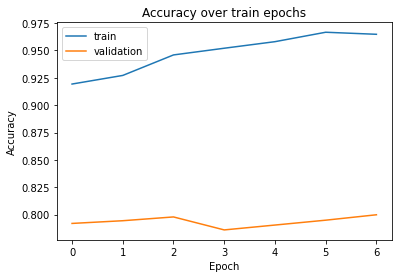

In [124]:
plt.plot(history_conv.history['accuracy'], label='train')
plt.plot(history_conv.history['val_accuracy'], label='validation')
plt.title('Accuracy over train epochs')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()

######################### train #########################
accuracy 0.8831980012492192


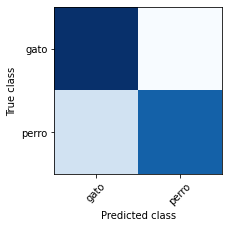

######################### validation #########################
accuracy 0.7795353435491844


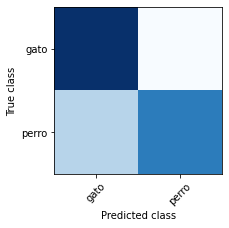

In [121]:
datasets = (
    ("train", train),
    ("validation", validation),   
)

for dataset_name, dataset in datasets:
    print('#' * 25, dataset_name, '#' * 25)

    # el dataset se itera en batches, así que calculams predicciones y labels por cada batch, y luego 
    # concatenamos todo
    batches_predictions = []
    batches_labels =  []
    
    for batch_images, batch_labels in dataset:
        # super importante: usamos argmax para convertir cosas de este formato:
        # [(0, 1, 0), (1, 0, 0), (1, 0, 0), (0, 0, 1)]
        # a este formato (donde tenemos el índice de la clase que tiene número más alto):
        # [1, 0, 0, 2]
        batches_predictions.append(np.argmax(model_cnn_3.predict(batch_images), axis=-1))
        batches_labels.append(np.argmax(batch_labels, axis=-1))

    predictions = np.concatenate(batches_predictions)
    labels = np.concatenate(batches_labels)
    
    print('accuracy', accuracy_score(labels, predictions))

    # graficamos la confussion matrix
    plt.figure(figsize=(3, 4))
        
    plt.xticks([0, 1], ANIMALES, rotation=45)
    plt.yticks([0, 1], ANIMALES)
    plt.xlabel('Predicted class')
    plt.ylabel('True class')

    plt.imshow(
        confusion_matrix(labels, predictions), 
        cmap=plt.cm.Blues,
        interpolation='nearest',
    )

    plt.show()

In [125]:
model_cnn_3 = Sequential([
    # el shape de los inputs es alto_imagen * ancho_imagen * cantidad_colores
    # usamos una capa de Rescaling para normalizar las entradas de los datasets
    Rescaling(1/255, input_shape=(64, 64, 3)),
    
    Convolution2D(filters=64, kernel_size=(2, 2), strides=1, activation='relu'),
    Dropout(0.1),
    MaxPooling2D(pool_size=(2, 2)), 
    
    Convolution2D(filters=64, kernel_size=(2, 2), strides=1, activation='relu'),
    Dropout(0.4),
    MaxPooling2D(pool_size=(2, 2)),
    
    Convolution2D(filters=128, kernel_size=(2, 2), strides=1, activation='relu'),
    Dropout(0.1),
    MaxPooling2D(pool_size=(2, 2)),
    
    Flatten(),
    
    Dense(128, activation='relu'),
    Dropout(0.4),
    
        
    Dense(1, activation='sigmoid'),
])

model_cnn_3.compile(
    optimizer='adam',
    loss='binary_crossentropy',
    metrics=['accuracy',],
)

In [126]:
history_conv = model_cnn_3.fit(
    train,
    epochs=7,
    batch_size=256,
    validation_data=validation,
)

Epoch 1/7
251/251 [==============================] - 73s 287ms/step - loss: 0.6960 - accuracy: 0.5292 - val_loss: 0.6606 - val_accuracy: 0.5952
Epoch 2/7
251/251 [==============================] - 71s 282ms/step - loss: 0.6154 - accuracy: 0.6648 - val_loss: 0.5749 - val_accuracy: 0.7222
Epoch 3/7
251/251 [==============================] - 71s 283ms/step - loss: 0.5650 - accuracy: 0.6992 - val_loss: 0.5555 - val_accuracy: 0.7420
Epoch 4/7
251/251 [==============================] - 71s 281ms/step - loss: 0.5299 - accuracy: 0.7346 - val_loss: 0.5559 - val_accuracy: 0.7533
Epoch 5/7
251/251 [==============================] - 72s 284ms/step - loss: 0.5057 - accuracy: 0.7520 - val_loss: 0.5351 - val_accuracy: 0.7514
Epoch 6/7
251/251 [==============================] - 71s 283ms/step - loss: 0.4671 - accuracy: 0.7786 - val_loss: 0.4864 - val_accuracy: 0.7805
Epoch 7/7
251/251 [==============================] - 71s 282ms/step - loss: 0.4337 - accuracy: 0.7941 - val_loss: 0.4827 - val_accuracy:

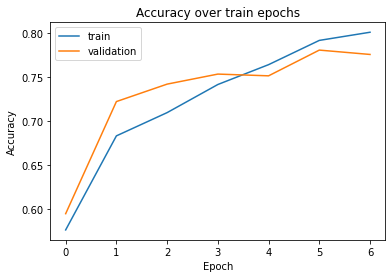

In [127]:
plt.plot(history_conv.history['accuracy'], label='train')
plt.plot(history_conv.history['val_accuracy'], label='validation')
plt.title('Accuracy over train epochs')
plt.ylabel('Accuracy')
plt.xlabel('Epoch')
plt.legend(loc='upper left')
plt.show()

######################### train #########################
accuracy 0.8339787632729544


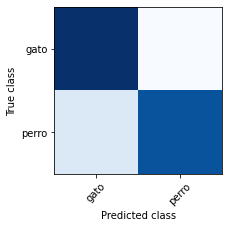

######################### validation #########################
accuracy 0.7755808205635195


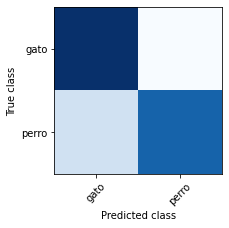

In [128]:
datasets = (
    ("train", train),
    ("validation", validation),   
)

for dataset_name, dataset in datasets:
    print('#' * 25, dataset_name, '#' * 25)

    # el dataset se itera en batches, así que calculams predicciones y labels por cada batch, y luego 
    # concatenamos todo
    batches_predictions = []
    batches_labels =  []
    
    for batch_images, batch_labels in dataset:
        # super importante: usamos argmax para convertir cosas de este formato:
        # [(0, 1, 0), (1, 0, 0), (1, 0, 0), (0, 0, 1)]
        # a este formato (donde tenemos el índice de la clase que tiene número más alto):
        # [1, 0, 0, 2]
        batches_predictions.append(np.argmax(model_cnn_3.predict(batch_images), axis=-1))
        batches_labels.append(np.argmax(batch_labels, axis=-1))

    predictions = np.concatenate(batches_predictions)
    labels = np.concatenate(batches_labels)
    
    print('accuracy', accuracy_score(labels, predictions))

    # graficamos la confussion matrix
    plt.figure(figsize=(3, 4))
        
    plt.xticks([0, 1], ANIMALES, rotation=45)
    plt.yticks([0, 1], ANIMALES)
    plt.xlabel('Predicted class')
    plt.ylabel('True class')

    plt.imshow(
        confusion_matrix(labels, predictions), 
        cmap=plt.cm.Blues,
        interpolation='nearest',
    )

    plt.show()

In [129]:
def show_and_predict_cnn(image_path):
    image_array = img_to_array(load_img(image_path, target_size=(64, 64)))
    inputs = np.array([image_array])  # armamos un "dataset" con solo esa imagen
    predictions = model_cnn_3.predict(inputs)
    display(Image(image_path, width=500))
    print("Prediction:", ANIMALES[np.argmax(predictions)])
    print("Prediction detail:", predictions)

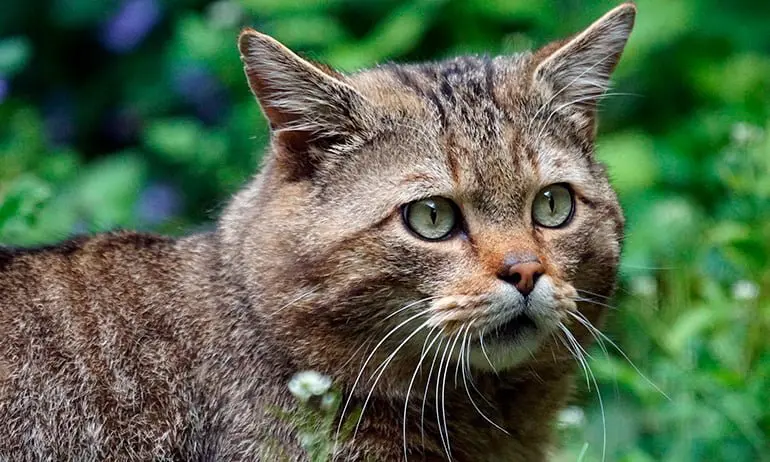

Prediction: perro
Prediction detail: [[0.24184516 0.7529917 ]]


In [130]:
show_and_predict_cnn("./prueba/gato.png")

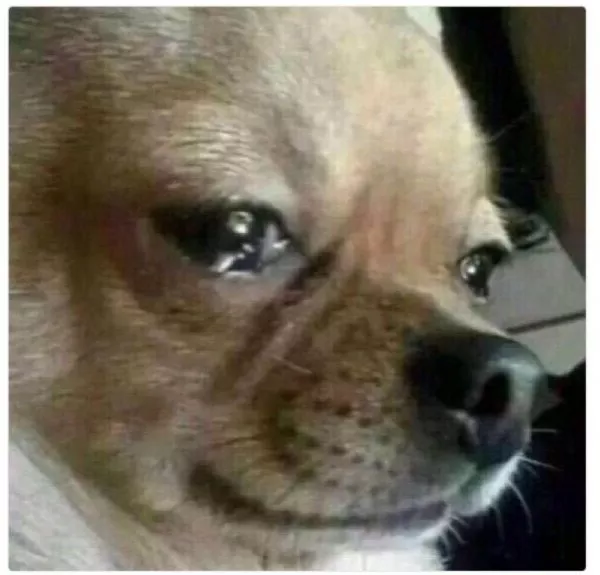

Prediction: gato
Prediction detail: [[0.6338472  0.37051755]]


In [131]:
show_and_predict_cnn("./prueba/perrito_llorando.png")

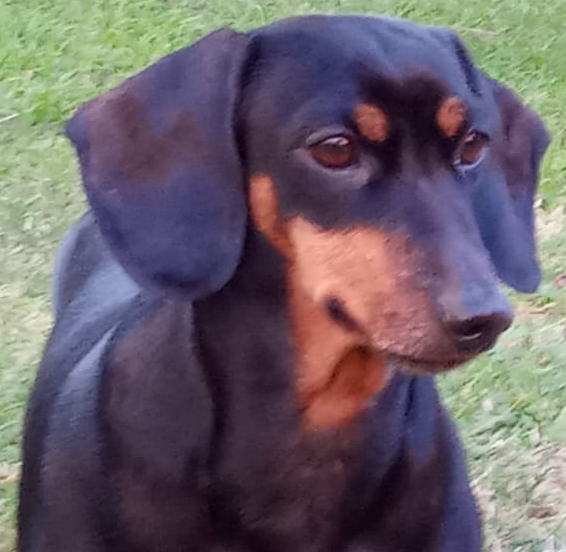

Prediction: perro
Prediction detail: [[0.18521255 0.8161853 ]]


In [132]:
show_and_predict_cnn("./prueba/cucurucho.png")

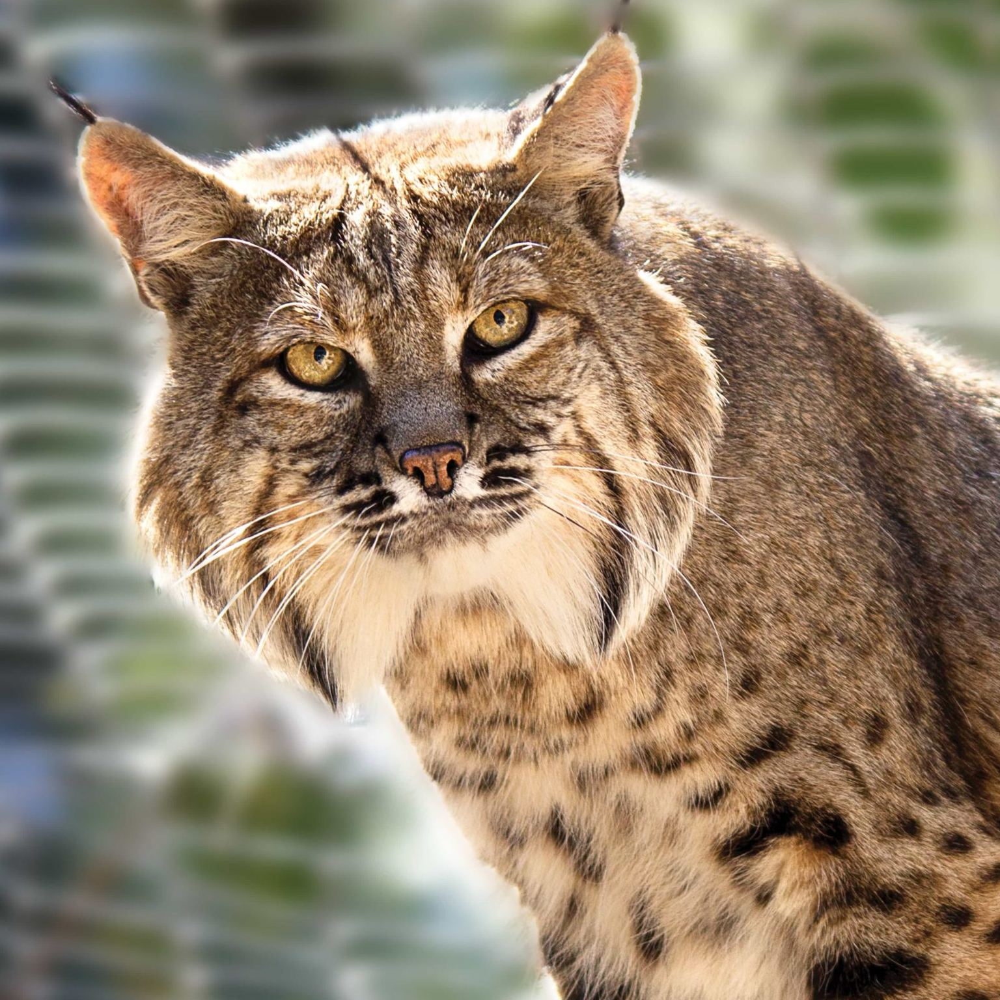

Prediction: perro
Prediction detail: [[0.4584276  0.53230083]]


In [133]:
show_and_predict_cnn("./prueba/gatomontes2.png")

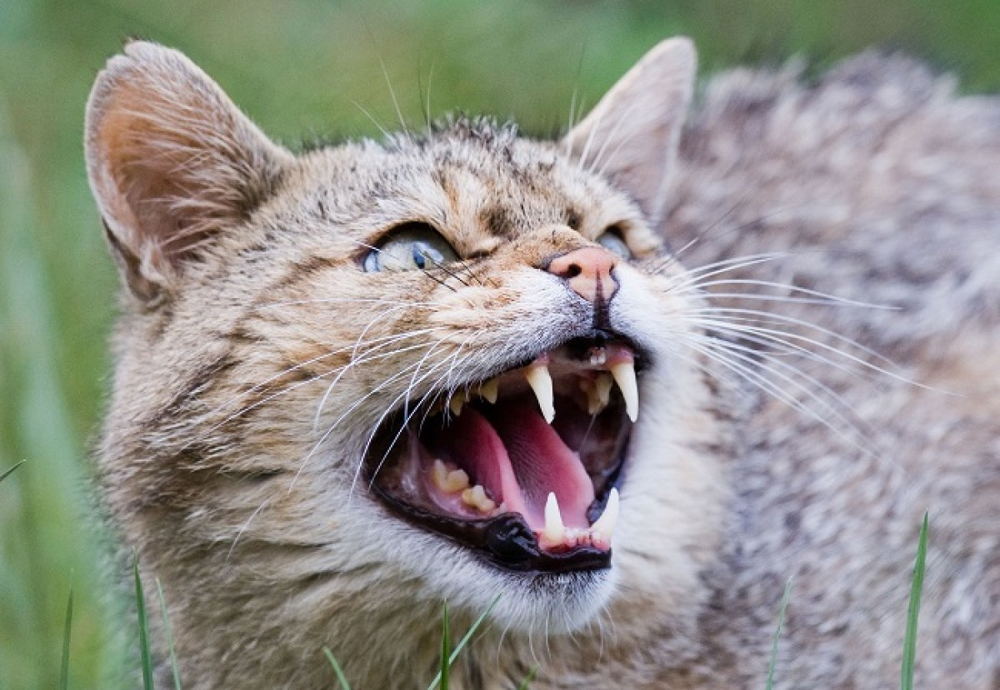

Prediction: perro
Prediction detail: [[0.28420234 0.7117969 ]]


In [134]:
show_and_predict_cnn("./prueba/gatomontes.png")

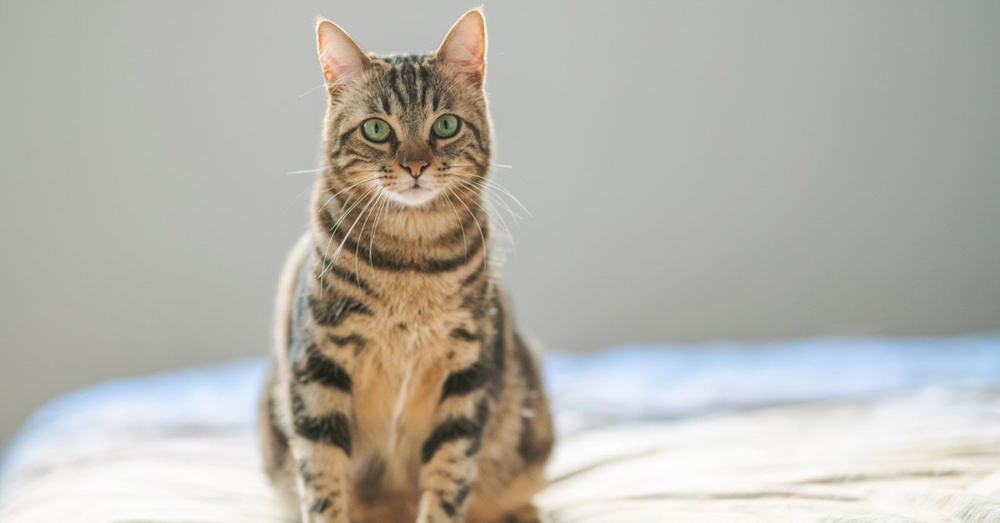

Prediction: gato
Prediction detail: [[0.6535584 0.3488959]]


In [135]:
show_and_predict_cnn("./prueba/gato2.png")

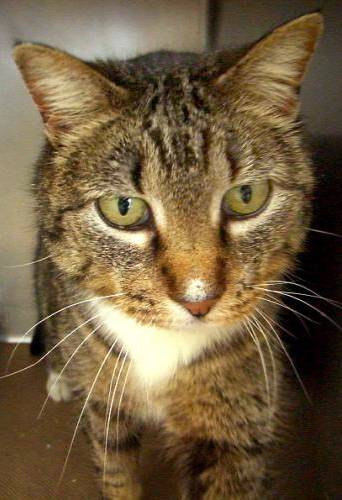

Prediction: gato
Prediction detail: [[0.8576575 0.1465182]]


In [136]:
show_and_predict_cnn("./test_set/gato/cat.4613.jpg")

# Conclusión

Como conclusión, luego de probar varias estructuras de redes convolucionales decidimos quedarnos con el modelo número 3 ya que a pesar de que el modelo número 1 da un mejor resultado en la métrica de accuracy (sólo por un 2%), podemos apreciar que el modelo número 3 no presenta overfit, a diferencia del modelo 1.

Realizamos varios experimentos con la propiedad Dropout, y llegamos a la conclusión que los modelos daban mejores resultados al variar los mismos entre las distintas capas de la red.

Al observar la matriz de confusión determinamos que el modelo generalmente se equivoca al arrojar la categoría "gato" como resultado.

## Mejora a desarrollar

Una mejora posible a desarrollar en un futuro puede ser utilizar la técnica de Data Augmentation. Mediante esta técnica, podriamos aumentar nuestro dataset de dos formas:

-Introducir "perturbaciones" en los datos originales, en donde tomamos imágenes de perros o gatos, y la replicamos descentrada, invirtiendo ejes, etc.

-Utilizar distintas distribuciones. Ej: para entrenar el modelo utilizando imágenes de alta resolución, añadimos imágenes de baja resolución o con ruido, siempre manteniendo mayor proporción de alta resolución. 

Esto va a contribuir a la generalización de las redes neuronales y así conseguir un aumento en el accuracy y la performance de estas.

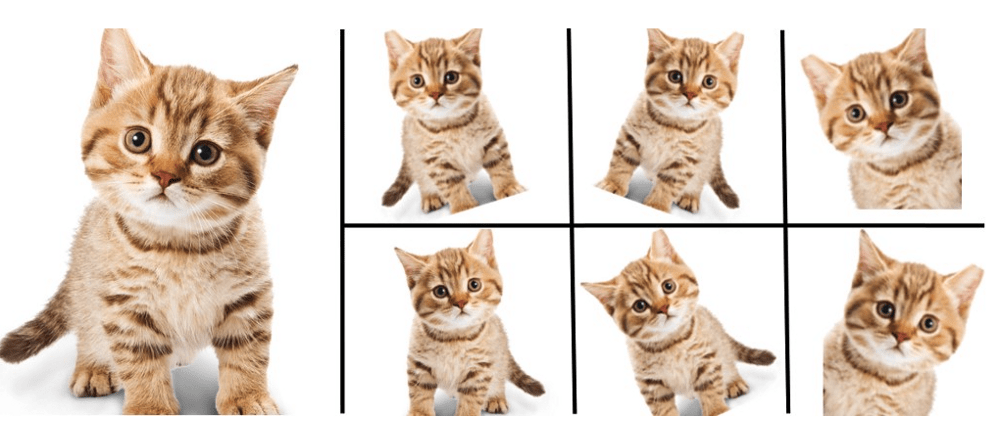